In [ ]:
import pybamm
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
plt.rcParams["animation.embed_limit"] = 100 # having animation size of 100Mb maximum


In [4]:
# taking the Single Particle Model (SPM)
model = pybamm.lithium_ion.SPM()
param = pybamm.ParameterValues("Chen2020") 
param.update({"Current function [A]": 1.0}) # Taking the 1C discharge as 1A for 1 hour



In [5]:
experiment = pybamm.Experiment(["Discharge at 1C for 1 hour"])
sim = pybamm.Simulation(model, parameter_values=param, experiment=experiment)
solution = sim.solve()

time = solution["Time [s]"].entries
c_s_n = solution["Negative particle concentration [mol.m-3]"]
voltage = solution["Terminal voltage [V]"]

r = c_s_n.mesh.nodes
r_norm = r / r.max()
times = np.arange(0, 3601, 5) # noting down time every 5 seconds



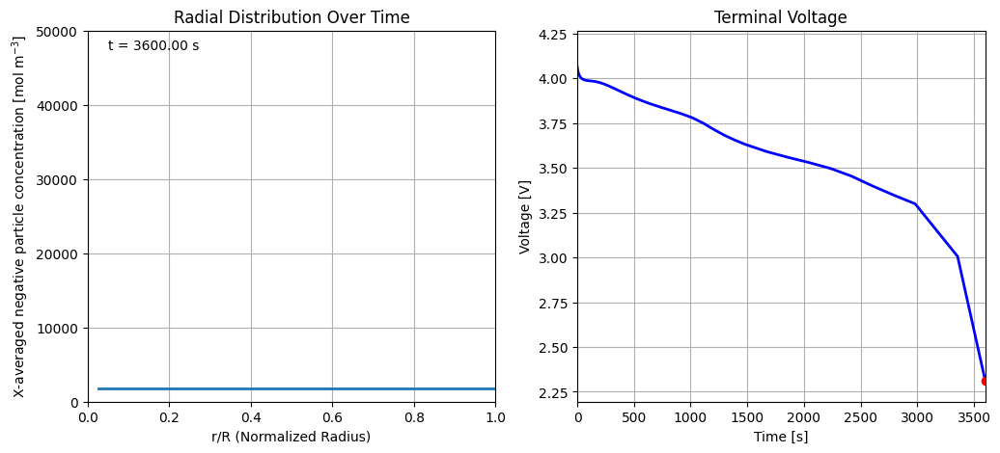

In [10]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

line_radial, = ax1.plot([], [], lw=2)
ax1.set_xlim(0, 1)
ax1.set_ylim(0, 50000)
ax1.set_xlabel("r/R (Normalized Radius)")
ax1.set_ylabel("X-averaged negative particle concentration [mol m$^{-3}$]")
ax1.set_title("Radial Distribution Over Time")
ax1.grid(True)

time_text = ax1.text(0.05, 0.95, "", transform=ax1.transAxes)

ax2.plot(time, voltage.entries, color="blue", lw=2)
dot_voltage, = ax2.plot([], [], "ro")
ax2.set_xlim(0, 3600)
ax2.set_ylim(voltage.entries.min() * 0.95, voltage.entries.max() * 1.05)
ax2.set_xlabel("Time [s]")
ax2.set_ylabel("Voltage [V]")
ax2.set_title("Terminal Voltage")
ax2.grid(True)

def update(i):
    t = times[i]
    c = c_s_n(t=t).mean(axis=0)
    v = voltage(t=t)
    line_radial.set_data(r_norm, c)
    dot_voltage.set_data([t], [v])
    time_text.set_text(f"t = {t:.2f} s")
    return line_radial, dot_voltage, time_text

ani = FuncAnimation(fig, update, frames=len(times), interval=500)

HTML(ani.to_jshtml())
